# 1. Background
San Francisco is among the top California counties for its rate of property and violent crime (California Criminal Justice Statistics Center, 2023). With a population of roughly 900,000 persons and close to 2000 sworn police officers  Links to an external site., the city has experienced growing crime. Or so they say Links to an external site.. In this problem set you will explore San Francisco crime patterns to answer questions with data. For example, what is the distribution of crime? Is violent and property crime equally distributed across the ten police districts? What happens when the city hires additional police officers? Can policy affect crime?

In [1]:
import matplotlib
import matplotlib.pyplot as plt
import scipy
import numpy as np
import pandas as pd
import seaborn as sns
import geopandas as gpd
import folium
import plotly
import json
import os
from folium.plugins import HeatMap
from branca.colormap import linear

# I would need the following libraries if I wanted to get data directly from the website.
# import requests
# import io


/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.3-CAPI-1.16.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


# 2. Gathering Data

In this problem set, you will be working with the San Francisco Police Department’s Incident Database. The dataset is continuously updated in real time, police officers report several variables associated to every report of a potential crime. The data for this problem set is publicly available,Links to an external site.  and you will need three files: 

report = Police Department Incident Reports 2018 to present (csv)

pol = San Francisco Police Districts (geojson)

an = San Francisco Analysis Neighborhoods (geojson)

In [2]:
# Comment below would be the correct way to get the newest
# data by directly downloading from the website.

# report = pd.read_csv(io.StringIO(requests.get(r'https://data.sfgov.org/api/views/wg3w-h783/rows.csv?accessType=DOWNLOAD').text))
# For size and time purposes, I will be using pre-downloaded files
# that are imported from class folder.

report = pd.read_csv("Police_Reports.csv")
report['Incident Time'] = pd.to_datetime(report['Incident Time'], format='%H:%M').dt.hour
report['Incident Date'] = pd.to_datetime(report['Incident Date'])
report['dt_Month'] = report['Incident Date'].dt.month_name()

pol = gpd.read_file("Current_Police_Districts.geojson")
an = gpd.read_file("Analysis_Neighborhoods.geojson")

In [3]:
report.head()

,Incident Datetime,Incident Date,Incident Time,Incident Year,Incident Day of Week,Report Datetime,Row ID,Incident ID,Incident Number,CAD Number,...,Point,Neighborhoods,ESNCAG - Boundary File,Central Market/Tenderloin Boundary Polygon - Updated,Civic Center Harm Reduction Project Boundary,HSOC Zones as of 2018-06-05,Invest In Neighborhoods (IIN) Areas,Current Supervisor Districts,Current Police Districts,dt_Month
0,2021/07/25 12:00:00 AM,2021-07-25,0,2021,Sunday,2021/07/25 01:41:00 PM,105718906372,1057189,216105573,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,July
1,2022/06/28 11:58:00 PM,2022-06-28,23,2022,Tuesday,2022/06/28 11:58:00 PM,116554371012,1165543,220264913,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,June
2,2022/03/11 10:30:00 AM,2022-03-11,10,2022,Friday,2022/03/11 08:03:00 PM,113048071000,1130480,226040232,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,March
3,2021/05/15 05:47:00 PM,2021-05-15,17,2021,Saturday,2021/05/15 05:47:00 PM,103051807043,1030518,210183345,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,May
4,2022/06/28 05:22:00 PM,2022-06-28,17,2022,Tuesday,2022/06/28 05:22:00 PM,116535107041,1165351,220361741,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,June


In [4]:
pol.head()

,shape_area,shape_leng,company,shape_le_1,district,geometry
0,91344142.1925,87550.2751419,B,100231.353916,SOUTHERN,"MULTIPOLYGON (((-122.39186 37.79425, -122.3917..."
1,201384622.317,163013.798332,C,144143.480351,BAYVIEW,"MULTIPOLYGON (((-122.38098 37.76480, -122.3810..."
2,80623839.7922,40152.783389,D,40518.8342346,MISSION,"MULTIPOLYGON (((-122.40954 37.76932, -122.4086..."
3,82781685.5603,56493.858208,E,50608.3103205,NORTHERN,"MULTIPOLYGON (((-122.43379 37.80793, -122.4337..."
4,11072154.5623,12424.2689691,J,18796.7841847,TENDERLOIN,"MULTIPOLYGON (((-122.40217 37.78626, -122.4171..."


In [5]:
an.head()

,nhood,geometry
0,Western Addition,"MULTIPOLYGON (((-122.42144 37.78557, -122.4213..."
1,West of Twin Peaks,"MULTIPOLYGON (((-122.46104 37.75096, -122.4605..."
2,Visitacion Valley,"MULTIPOLYGON (((-122.40385 37.71883, -122.4035..."
3,Twin Peaks,"MULTIPOLYGON (((-122.44695 37.75655, -122.4459..."
4,South of Market,"MULTIPOLYGON (((-122.40371 37.78404, -122.4027..."


# 3. City Crime Trends

## 3.1 

First, compute and report out the following to get a handle on the data.

A. Provide citywide annual counts of reported incidents in a table.

B. Provide citywide counts by month of reported incidents in a table. 

C. Calculate and plot the cumulative distribution of incidents by category.

D. Identify the top ten most frequent incidents.

E. Provide a single visualization of the monthly counts of incidents for the ten top categories (make sure your audience can understand it).

F. Provide a summary report (in no more than 200 words) of the descriptive statistics that highlights what (in your judgment) your audience needs to know.


### 3.1.A

In [6]:
yr_ind = np.array(report.groupby('Incident Year')['Incident Year'].count().index)
yr_count = np.array(report.groupby('Incident Year')['Incident Year'].count()[:])
a = {'Count': yr_count}
yr_count_df = pd.DataFrame(data = a, index = yr_ind)

In [7]:
yr_count_df

,Count
2018,152648
2019,148242
2020,118264
2021,128695
2022,133359
2023,19137


### 3.1.B

In [8]:
months = ["January", "February", "March", "April", "May", "June", "July","August", "September", "October", "November", "December"]

mnt_count = report.groupby(report['Incident Date'].dt.month_name().rename('Month')).count().reset_index().rename(columns={'Incident Date':'count'})
mnt_count = mnt_count.sort_values('Month', key = lambda y : pd.Categorical(y, categories=months, ordered=True))
mnt_count = mnt_count[['Month', 'count']].set_index('Month')
mnt_count

,count
Month,
January,69184
February,61915
March,54289
April,52379
May,55669
June,55692
July,59680
August,59748
September,58251


### 3.1.C

In [9]:
len(report['Incident Category'].unique())

50

There are about 50 different types of incidents listed in 'Incident Category' column. I will be plotting the top 5 while excluding 'Other Miscellaneous' and 'Non-Criminal'. Plotting cdf of the two is not useful because we do not know exact details of the incident.

In [10]:
top_5 = np.array(report['Incident Category'].value_counts(ascending = False).reset_index().drop([1, 4])[:5]['index'])
top_5

array(['Larceny Theft', 'Malicious Mischief', 'Assault', 'Burglary',
       'Motor Vehicle Theft'], dtype=object)

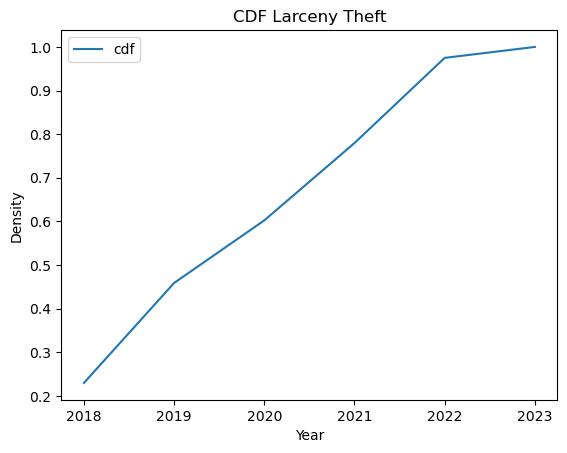

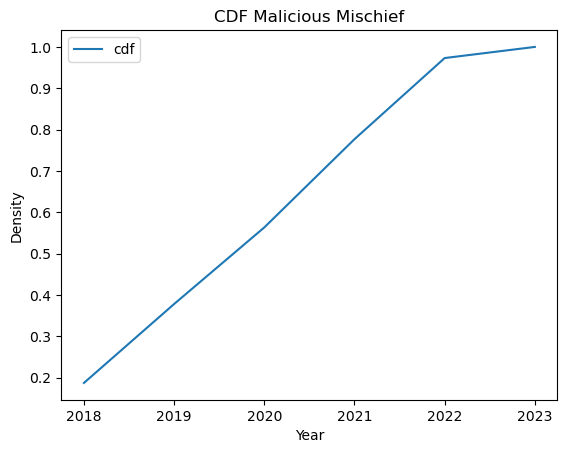

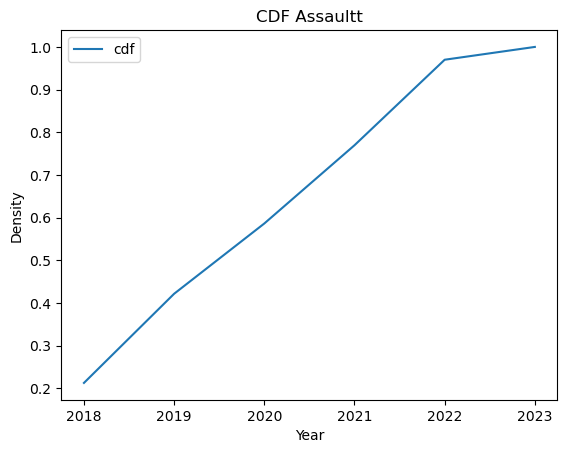

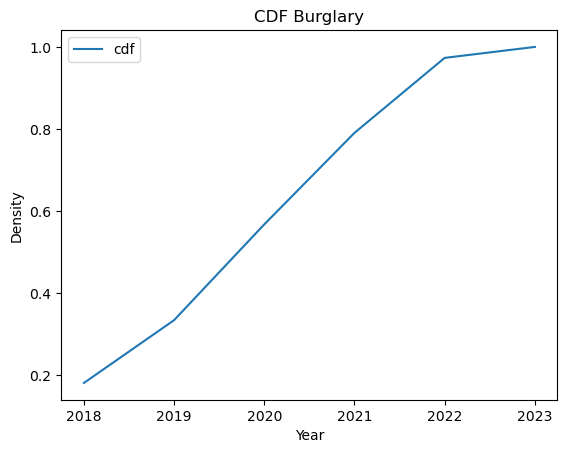

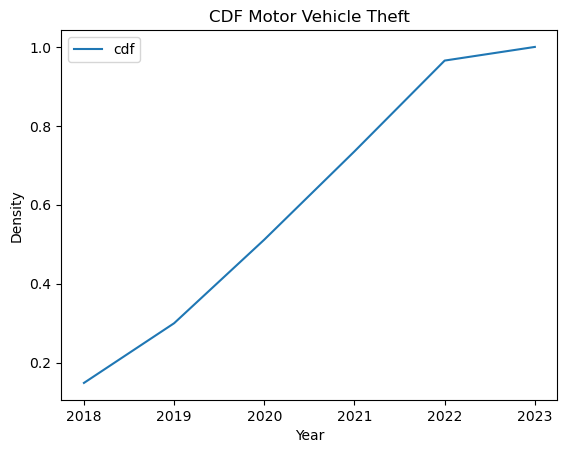

In [11]:
x = report.loc[report['Incident Category'] == 'Larceny Theft']
yr = np.array(x.groupby('Incident Year').count()['Incident Datetime'].index)
pdf = np.array(x.groupby('Incident Year').count()['Incident Datetime']) / len(x)
cdf = np.cumsum(pdf)
xx = pd.DataFrame(data = {'yr':yr, 'cdf':cdf})
xx.plot(x = 'yr', y = 'cdf')
plt.title('CDF Larceny Theft')
plt.xlabel('Year')
plt.ylabel('Density');

x = report.loc[report['Incident Category'] == 'Malicious Mischief']
yr = np.array(x.groupby('Incident Year').count()['Incident Datetime'].index)
pdf = np.array(x.groupby('Incident Year').count()['Incident Datetime']) / len(x)
cdf = np.cumsum(pdf)
xx = pd.DataFrame(data = {'yr':yr, 'cdf':cdf})
xx.plot(x = 'yr', y = 'cdf')
plt.title('CDF Malicious Mischief')
plt.xlabel('Year')
plt.ylabel('Density');

x = report.loc[report['Incident Category'] == 'Assault']
yr = np.array(x.groupby('Incident Year').count()['Incident Datetime'].index)
pdf = np.array(x.groupby('Incident Year').count()['Incident Datetime']) / len(x)
cdf = np.cumsum(pdf)
xx = pd.DataFrame(data = {'yr':yr, 'cdf':cdf})
xx.plot(x = 'yr', y = 'cdf')
plt.title('CDF Assaultt')
plt.xlabel('Year')
plt.ylabel('Density');

x = report.loc[report['Incident Category'] == 'Burglary']
yr = np.array(x.groupby('Incident Year').count()['Incident Datetime'].index)
pdf = np.array(x.groupby('Incident Year').count()['Incident Datetime']) / len(x)
cdf = np.cumsum(pdf)
xx = pd.DataFrame(data = {'yr':yr, 'cdf':cdf})
xx.plot(x = 'yr', y = 'cdf')
plt.title('CDF Burglary')
plt.xlabel('Year')
plt.ylabel('Density');

x = report.loc[report['Incident Category'] == 'Motor Vehicle Theft']
yr = np.array(x.groupby('Incident Year').count()['Incident Datetime'].index)
pdf = np.array(x.groupby('Incident Year').count()['Incident Datetime']) / len(x)
cdf = np.cumsum(pdf)
xx = pd.DataFrame(data = {'yr':yr, 'cdf':cdf})
xx.plot(x = 'yr', y = 'cdf')
plt.title('CDF Motor Vehicle Theft')
plt.xlabel('Year')
plt.ylabel('Density');

### 3.1.D

In [12]:
report['Incident Category'].value_counts(ascending = False)[:10]

Larceny Theft          213496
Other Miscellaneous     48893
Malicious Mischief      47368
Assault                 42600
Non-Criminal            41784
Burglary                39461
Motor Vehicle Theft     35696
Recovered Vehicle       27189
Fraud                   22186
Lost Property           20395
Name: Incident Category, dtype: int64

### 3.1.E

In [13]:
top_ten = np.array(report['Incident Category'].value_counts(ascending = False)[:10].index)
top_ten_df = report.loc[report['Incident Category'].isin(top_ten)]
top_ten_df = top_ten_df.groupby(report['Incident Date'].dt.month_name().rename('Month')).count().reset_index().rename(columns={'Incident Date':'count'})
top_ten_df = top_ten_df.sort_values('Month', key = lambda y : pd.Categorical(y, categories=months, ordered=True))
top_ten_count = top_ten_df[['Month', 'count']].set_index('Month')

Here is the count of all years per month

In [14]:
top_ten_count

,count
Month,
January,53047
February,46568
March,41271
April,40011
May,42844
June,43349
July,46325
August,45973
September,45056


In [15]:
mth_count = []
count = []
for i in range(len(months)):
    for j in range(len(top_ten)):
        count.append(len(report[(report['dt_Month'] == months[i]) & (report['Incident Category'] == top_ten[j])]))
    mth_count.append(count)
    count = []

Here is the monthly counts of incidents for the top ten. If we add every rows, the number matches with the count from the chart above.

In [16]:
top_ten_month_count = pd.DataFrame(data = mth_count, columns = top_ten, index = months)
top_ten_month_count

,Larceny Theft,Other Miscellaneous,Malicious Mischief,Assault,Non-Criminal,Burglary,Motor Vehicle Theft,Recovered Vehicle,Fraud,Lost Property
January,21253,4935,4646,3906,4010,4011,3433,2726,2219,1908
February,17874,4491,4059,3688,3640,3312,3227,2563,1914,1800
March,15868,3897,3672,3413,3340,2983,2588,2013,1795,1702
April,14842,3918,3834,3280,3207,3151,2538,1913,1770,1558
May,16420,3935,3834,3508,3383,3562,2791,2102,1773,1536
June,17040,3663,3931,3579,3407,3103,2874,2127,1866,1759
July,18405,4137,4149,3579,3449,3500,3128,2281,2031,1666
August,18196,4206,4042,3600,3733,3389,2922,2301,1809,1775
September,18048,4244,3924,3721,3611,3042,2833,2188,1766,1679
October,19269,4016,4070,3725,3574,3049,3165,2335,1794,1755


### 3.1.F

We can see that the number of incidents are relatively similar across all the years; they are between 12,000 to 15,000. Year 2023 does not count as it hasn’t been a full year yet. We notice the slight decrease in incidents in year 2020. This is most likely due to COVID-19. When we look at each of top incidents by month (graph 3.1.E), we see that January has the highest count of all months in every incident. This is a good information that audience needs to know; January is the most ‘dangerous’ month. Something else to keep in mind is that we don’t know much about ‘Other Miscellaneous’ and ‘Non-Criminal’ incidents. If we want to know more, we would need to perform more EDA. 

## 3.2
Plot the number of incidents per year from 2018 to present, then plot the number of incidents per month per year from 2018 to present. What do the two plots you just produced tell you about the incident reports?

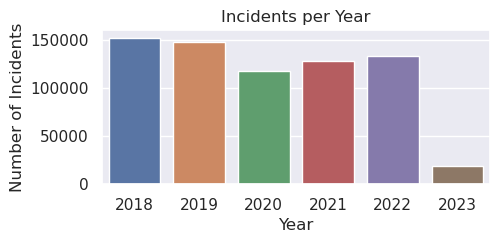

In [17]:
sns.set(rc={'figure.figsize':(5, 2)})
yr_mnt_count = report.groupby([report['Incident Date'].dt.year.rename('Year')]).count()['Incident Date'].reset_index().rename(columns={'Incident Date':'count'})
sns.barplot(x = yr_mnt_count['Year'], y = yr_mnt_count['count'])
plt.ylabel('Number of Incidents')
plt.title('Incidents per Year');

In [18]:
yr_mnt_count = report.groupby([report['Incident Date'].dt.year.rename('Year'),
                       report['Incident Date'].dt.month_name().rename('Month')]).count()['Incident Date'].reset_index().rename(columns={'Incident Date':'count'})
yr_mnt_count['Month'] = pd.Categorical(yr_mnt_count['Month'], categories=months, ordered=True)
yr_mnt_count = yr_mnt_count.sort_values(by = ['Year', 'Month'], ascending = [True, True])
d_months = {"January":1, "February":2, "March":3, "April":4, "May":5, "June":6, "July":7, "August":8, "September":9, "October":10, "November":11, "December":12}
yr_mnt_count['Month'] = yr_mnt_count['Month'].map(d_months)

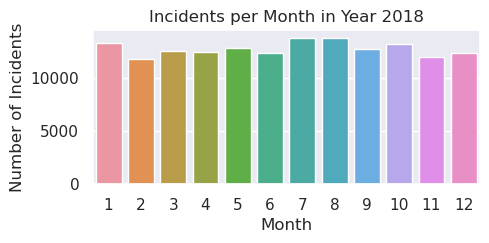

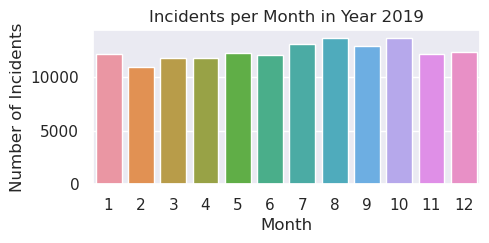

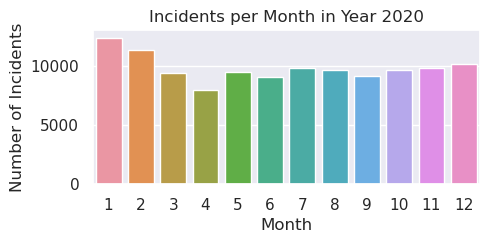

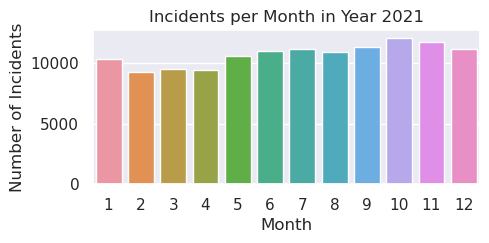

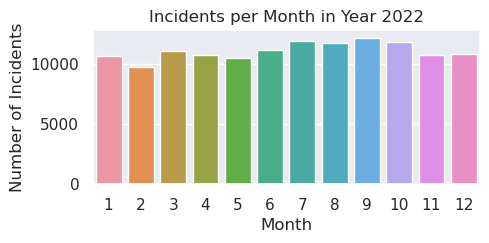

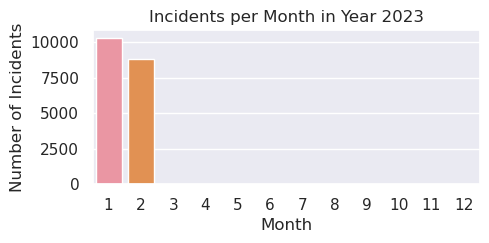

In [19]:
for i in range(6):
    curr_yr = yr_mnt_count.loc[yr_mnt_count['Year'] == 2018 + i]
    sns.barplot(x = curr_yr['Month'], y = curr_yr['count'])
    plt.ylabel('Number of Incidents')
    yr = 2018 + i
    plt.title('Incidents per Month in Year %i' % yr)
    plt.show();
    i += 1

When we look at the per year plot, we can see that reported incidents have dropped significantly in year 2020. I believe this is due to COVID-19. When we take a look at per month per year plots, we can see that every plot is roughly uniformally distributed. 

## 3.3 
Summarize the data over other time measures, day of week and time of day. Is there a relationship between day of week, time, and whether an incident occurs? Provide at least one visualization to help readers understand the data at this level.

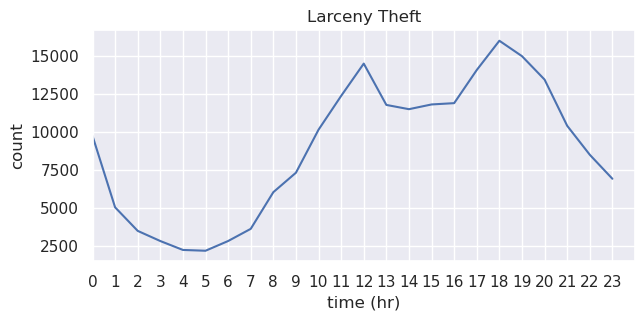

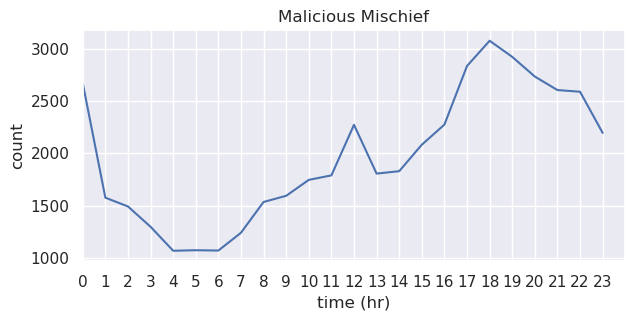

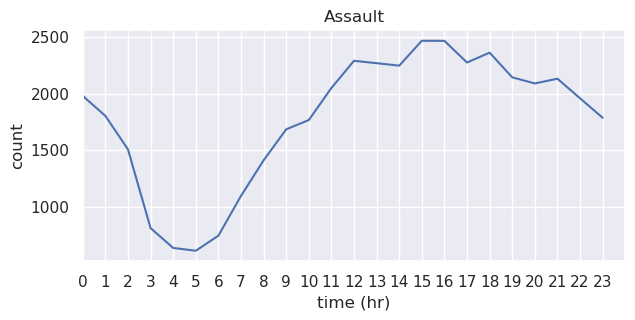

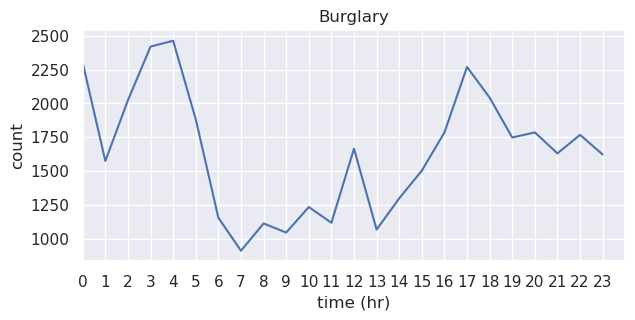

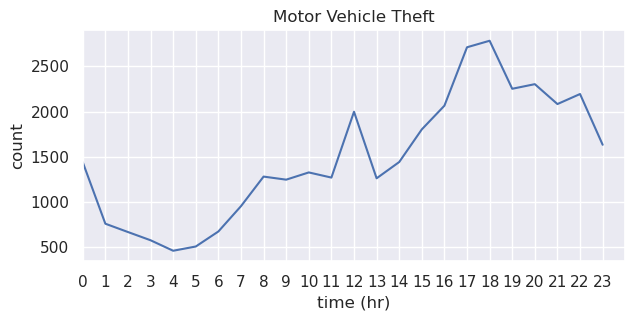

In [20]:
lt = report.loc[report['Incident Category'] == 'Larceny Theft'][['Incident Category', 'Incident Time']]
x =  lt['Incident Time'].value_counts()
y = x.reset_index().sort_values('index')
fig, ax = plt.subplots(figsize=(7, 3))
ax.set_xlim(0, 24)
ax.set_xticks(range(0, 24))
sns.lineplot(data=y, x = 'index', y = 'Incident Time', ax=ax)
plt.title('Larceny Theft')
plt.xlabel('time (hr)')
plt.ylabel('count');
mm = report.loc[report['Incident Category'] == 'Malicious Mischief'][['Incident Category', 'Incident Time']]
x =  mm['Incident Time'].value_counts()
y = x.reset_index().sort_values('index')
fig, ax = plt.subplots(figsize=(7, 3))
ax.set_xlim(0, 24)
ax.set_xticks(range(0, 24))
sns.lineplot(data=y, x = 'index', y = 'Incident Time', ax=ax)
plt.title('Malicious Mischief')
plt.xlabel('time (hr)')
plt.ylabel('count');
a = report.loc[report['Incident Category'] == 'Assault'][['Incident Category', 'Incident Time']]
x =  a['Incident Time'].value_counts()
y = x.reset_index().sort_values('index')
fig, ax = plt.subplots(figsize=(7, 3))
ax.set_xlim(0, 24)
ax.set_xticks(range(0, 24))
sns.lineplot(data=y, x = 'index', y = 'Incident Time', ax=ax)
plt.title('Assault')
plt.xlabel('time (hr)')
plt.ylabel('count');
b = report.loc[report['Incident Category'] == 'Burglary'][['Incident Category', 'Incident Time']]
x =  b['Incident Time'].value_counts()
y = x.reset_index().sort_values('index')
fig, ax = plt.subplots(figsize=(7, 3))
ax.set_xlim(0, 24)
ax.set_xticks(range(0, 24))
sns.lineplot(data=y, x = 'index', y = 'Incident Time', ax=ax)
plt.title('Burglary')
plt.xlabel('time (hr)')
plt.ylabel('count');
mvt = report.loc[report['Incident Category'] == 'Motor Vehicle Theft'][['Incident Category', 'Incident Time']]
x =  mvt['Incident Time'].value_counts()
y = x.reset_index().sort_values('index')
fig, ax = plt.subplots(figsize=(7, 3))
ax.set_xlim(0, 24)
ax.set_xticks(range(0, 24))
sns.lineplot(data=y, x = 'index', y = 'Incident Time', ax=ax)
plt.title('Motor Vehicle Theft')
plt.xlabel('time (hr)')
plt.ylabel('count');

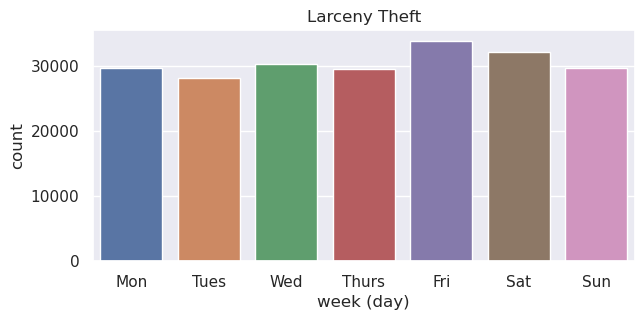

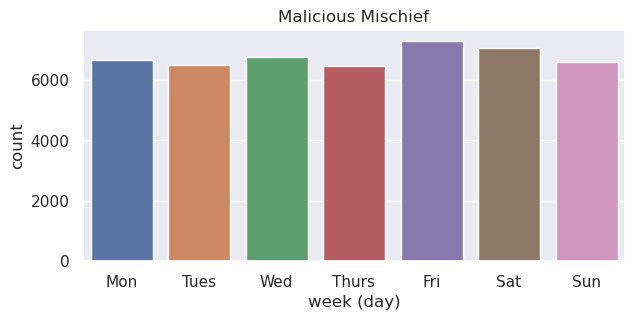

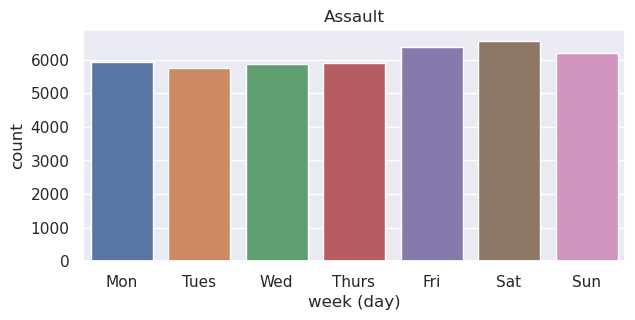

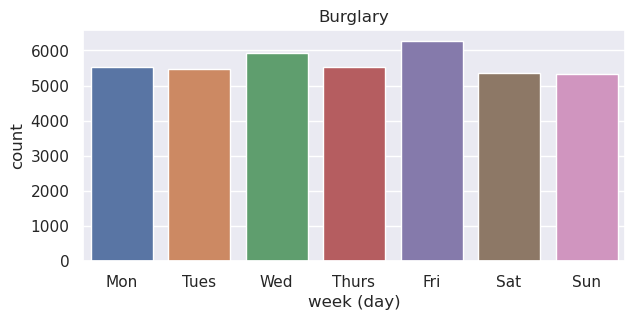

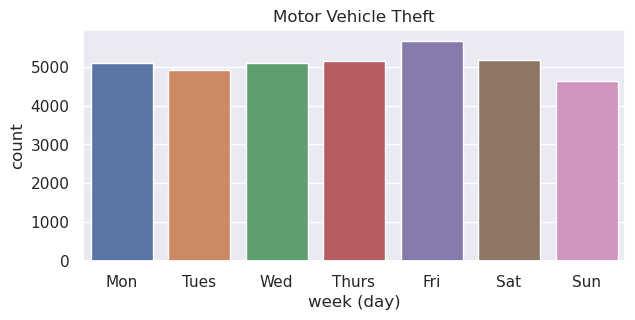

In [21]:
week = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
days = {'Monday':'Mon', 'Tuesday':'Tues', 'Wednesday':'Wed', 'Thursday':'Thurs', 'Friday':'Fri', 'Saturday':'Sat', 'Sunday':'Sun'}

lt = report.loc[report['Incident Category'] == 'Larceny Theft'][['Incident Category', 'Incident Day of Week']]
x = lt['Incident Day of Week'].value_counts()
x = x.reset_index()
x['index'] = pd.Categorical(x['index'], categories = week, ordered = True)
x = x.sort_values('index')
x['index'] = x['index'].apply(lambda x: days[x])
fig, ax = plt.subplots(figsize=(7, 3))
sns.barplot(data=x, x = 'index', y = 'Incident Day of Week', ax=ax)
plt.title('Larceny Theft')
plt.xlabel('week (day)')
plt.ylabel('count');

lt = report.loc[report['Incident Category'] == 'Malicious Mischief'][['Incident Category', 'Incident Day of Week']]
x = lt['Incident Day of Week'].value_counts()
x = x.reset_index()
x['index'] = pd.Categorical(x['index'], categories = week, ordered = True)
x = x.sort_values('index')
x['index'] = x['index'].apply(lambda x: days[x])
fig, ax = plt.subplots(figsize=(7, 3))
sns.barplot(data=x, x = 'index', y = 'Incident Day of Week', ax=ax)
plt.title('Malicious Mischief')
plt.xlabel('week (day)')
plt.ylabel('count');

lt = report.loc[report['Incident Category'] == 'Assault'][['Incident Category', 'Incident Day of Week']]
x = lt['Incident Day of Week'].value_counts()
x = x.reset_index()
x['index'] = pd.Categorical(x['index'], categories = week, ordered = True)
x = x.sort_values('index')
x['index'] = x['index'].apply(lambda x: days[x])
fig, ax = plt.subplots(figsize=(7, 3))
sns.barplot(data=x, x = 'index', y = 'Incident Day of Week', ax=ax)
plt.title('Assault')
plt.xlabel('week (day)')
plt.ylabel('count');

lt = report.loc[report['Incident Category'] == 'Burglary'][['Incident Category', 'Incident Day of Week']]
x = lt['Incident Day of Week'].value_counts()
x = x.reset_index()
x['index'] = pd.Categorical(x['index'], categories = week, ordered = True)
x = x.sort_values('index')
x['index'] = x['index'].apply(lambda x: days[x])
fig, ax = plt.subplots(figsize=(7, 3))
sns.barplot(data=x, x = 'index', y = 'Incident Day of Week', ax=ax)
plt.title('Burglary')
plt.xlabel('week (day)')
plt.ylabel('count');

lt = report.loc[report['Incident Category'] == 'Motor Vehicle Theft'][['Incident Category', 'Incident Day of Week']]
x = lt['Incident Day of Week'].value_counts()
x = x.reset_index()
x['index'] = pd.Categorical(x['index'], categories = week, ordered = True)
x = x.sort_values('index')
x['index'] = x['index'].apply(lambda x: days[x])
fig, ax = plt.subplots(figsize=(7, 3))
sns.barplot(data=x, x = 'index', y = 'Incident Day of Week', ax=ax)
plt.title('Motor Vehicle Theft')
plt.xlabel('week (day)')
plt.ylabel('count');

When it comes to time by hour, we can see around which time (hr) people tend commit each idividual crime. One interesting thing I found is that the rate of all the top four crimes (except burglary) is high around between afternoon and evening. But burglary is very high in midnight. This makes sense since burglars are less likely to get caught during late night. For the day of the week, each plot seems relatively similar. One thing that caught my attention is that all of them are at peak on Fridays and/or Saturdays.

## 3.4
Is there a relationship between day/time and particular types of incidents? What about time of year and particular types of incidents?

I will be accessing year 2018 as it has the most incident out of all the years.

In [22]:
yr18 = report.loc[report['Incident Year'] == 2018]
top_5 = np.array(yr18['Incident Category'].value_counts(ascending = False).reset_index().drop([1, 2])[:5]['index'])
top_5_df = report.loc[report['Incident Category'].isin(top_5)]
top_5_df = top_5_df.groupby(report['Incident Date'].dt.month_name().rename('Month')).count().reset_index().rename(columns={'Incident Date':'count'})

top_5_df = top_5_df.sort_values('Month', key = lambda y : pd.Categorical(y, categories=months, ordered=True))
top_5_count = top_5_df[['Month', 'count']].set_index('Month')
mth_count = []
count = []
for i in range(len(months)):
    for j in range(len(top_5)):
        count.append(len(report[(report['dt_Month'] == months[i]) & (report['Incident Category'] == top_5[j])]))
    mth_count.append(count)
    count = []

top_5_month_count = pd.DataFrame(data = mth_count, columns = top_5, index = months)
top_5_month_count

,Larceny Theft,Assault,Malicious Mischief,Burglary,Lost Property
January,21253,3906,4646,4011,1908
February,17874,3688,4059,3312,1800
March,15868,3413,3672,2983,1702
April,14842,3280,3834,3151,1558
May,16420,3508,3834,3562,1536
June,17040,3579,3931,3103,1759
July,18405,3579,4149,3500,1666
August,18196,3600,4042,3389,1775
September,18048,3721,3924,3042,1679
October,19269,3725,4070,3049,1755


Here we can see that Burglary is relatively high between December - January and July - Augustcompared to other months. This is most likely due to summer vacation and holiday seasons. Morepeople are travelling for vacation or be out of town for holiday union; hence, more burglaries aremore likely to happen around these times.

## 3.5
What police districts experience the most crime? Do different police districts experience different types of crimes at different rates, or is the distribution of crime spatially consistent across police districts?

In [23]:
dist = report.groupby(by='Police District').count().reset_index()[['Police District', 'Incident Date']].rename(columns={'Incident Date':'count'})
dist = dist.sort_values('count', ascending = False)
dist

,Police District,count
1,Central,104820
4,Northern,95208
3,Mission,87745
8,Southern,84270
10,Tenderloin,67502
0,Bayview,62163
2,Ingleside,52994
9,Taraval,49003
7,Richmond,43673
6,Park,32293


There are 10 districts, I will be analyzing 3 most crimes committed districts. For each district, I will be looking top 7 incidents.

In [24]:
dist.head(3)

,Police District,count
1,Central,104820
4,Northern,95208
3,Mission,87745


Larceny Theft          45877
Malicious Mischief      7710
Other Miscellaneous     6957
Non-Criminal            5904
Burglary                5659
Assault                 4818
Lost Property           3771
Name: Incident Category, dtype: int64


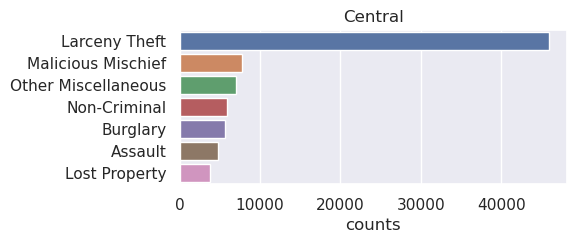

In [25]:
central = report.loc[report['Police District'] == 'Central']
counts = central['Incident Category'].value_counts(ascending = False)[:7]
print(counts)
sns.barplot(x = counts, y = counts.index)
plt.title('Central')
plt.xlabel('counts');

Larceny Theft          38849
Burglary                6837
Malicious Mischief      6752
Other Miscellaneous     5748
Assault                 4805
Non-Criminal            4657
Motor Vehicle Theft     3939
Name: Incident Category, dtype: int64


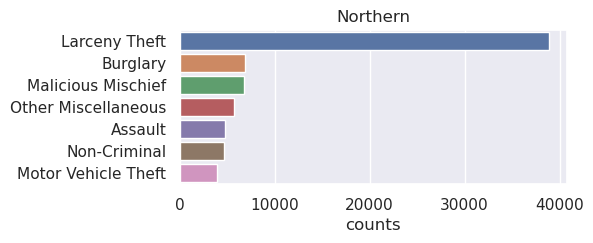

In [26]:
northern = report.loc[report['Police District'] == 'Northern']
counts = northern['Incident Category'].value_counts(ascending = False)[:7]
print(counts)
sns.barplot(x = counts, y = counts.index)
plt.title('Northern')
plt.xlabel('counts');

Larceny Theft          22509
Other Miscellaneous     8307
Assault                 6988
Malicious Mischief      6100
Non-Criminal            4935
Motor Vehicle Theft     4725
Burglary                4598
Name: Incident Category, dtype: int64


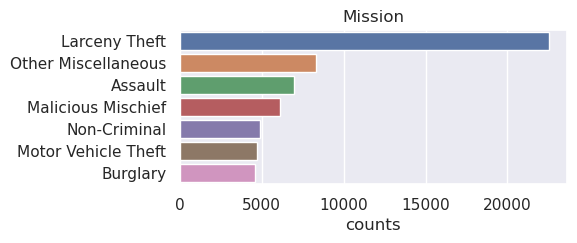

In [27]:
mission = report.loc[report['Police District'] == 'Mission']
counts = mission['Incident Category'].value_counts(ascending = False)[:7]
print(counts)
sns.barplot(x = counts, y = counts.index)
plt.title('Mission')
plt.xlabel('counts');

Based on the plots, we can see that larceny theft is most committed crime in every district. Besides larceny theft, every district experiences different rate of each crime, but we can see that most of them are in the top 7 in slightly different order. Distribution of each district is similar where larceny theft is the outlier.

## 3.6
Discuss one other interesting finding from your data in a few sentences, and use a visualization.




Because I excluded 'Other Miscellaneous', I wanted to see find out more details about it. Since Central district is the most incidental, I will be accessing this district.

In [28]:
import re
from collections import Counter
x = central.loc[central['Incident Category'] == 'Other Miscellaneous']['Incident Description'].unique().tolist()
b = " ".join(x).lower()
words = re.findall(r'\w+', b)
x = np.array(Counter(words).most_common(10))
word, count = [], []
for i in range(len(x)):
    word.append(x[i][0])
    count.append(x[i][1])
word = (np.array(word))
count = (np.array(count)).astype(int)
df = pd.DataFrame(data = {'word':word, 'count':count})

Creating visualization to see more details of the incident

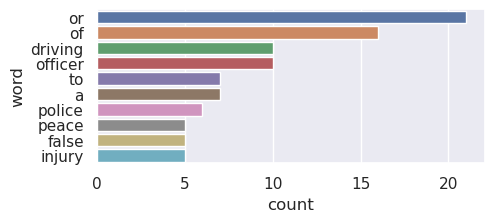

In [29]:
sns.barplot(data=df, y = 'word', x = 'count');

Getting rid of conjunction and preposition words, the word driving is the most frequently used in 'Other Miscellaneous.' My guess is that the incident is driving under the influence. 

# 4. Geographic distribution of crime

## 4.1
Plot individual incidents in 2019 as points on a map of San Francisco, delimiting the 10 police districts. You’ll want to use Folium (as in the labs) and Geopandas, which extends DataFrames from pandas to GeoDataFrames, which include geographic information. Find the documentation on GeoDataFrames here.Links to an external site.

A. Over what spatial unit does crime seem to cluster?

B. Shade the points by type of crime and analyze whether certain areas experience certain types of crime more often.

C. Propose social scientific explanations for the patterns that you find

In [30]:
us_states = os.path.join('data', 'us-states.json')
geo_json_data = json.load(open(us_states))
sf_coords = (37.76, -122.45)
sf_map = folium.Map(sf_coords, zoom_start = 12)
lt_map = folium.Map(sf_coords, zoom_start = 12)
b_map = folium.Map(sf_coords, zoom_start = 12)
a_map = folium.Map(sf_coords, zoom_start = 12)
sf_ch_map = folium.Map(sf_coords, zoom_start = 12)
sf_hm_map = folium.Map(sf_coords, zoom_start = 12)
sf_ch_map_morn = folium.Map(sf_coords, zoom_start = 12)
sf_ch_map_night = folium.Map(sf_coords, zoom_start = 12)

I will choose top 3 most crime which are larceny theft, burglar, and assault. For each incident, I will be sampling 100 to reduce time and memory of Notebook. Sampling would work here because if there are most incidents in certain areas, it will still show because each point has equal probability of getting selected.

In [31]:
ten_pd_report = report.loc[(report['Police District'] != 'Out of SF') & (report['Incident Year'] == 2019)]

lt = ten_pd_report.loc[ten_pd_report['Incident Category'] == 'Larceny Theft'][['Longitude', 'Latitude']].dropna()
b = ten_pd_report.loc[ten_pd_report['Incident Category'] == 'Burglary'][['Longitude', 'Latitude']].dropna()
a = ten_pd_report.loc[ten_pd_report['Incident Category'] == 'Assault'][['Longitude', 'Latitude']].dropna()

In [32]:
lt = lt.sample(n = 200)
b = b.sample(n = 200)
a = a.sample(n = 200)

In [33]:
lat = lt['Latitude'].values
lon = lt['Longitude'].values
ltt = np.vstack((lat, lon)).transpose().tolist()

lat = b['Latitude'].values
lon = b['Longitude'].values
bb = np.vstack((lat, lon)).transpose().tolist()

lat = a['Latitude'].values
lon = a['Longitude'].values
aa = np.vstack((lat, lon)).transpose().tolist()

for i in range(200):
    folium.Marker(location = ltt[i], popup = 'Larceny Theft', icon = folium.Icon(color = 'green')).add_to(lt_map)
    folium.Marker(location = bb[i], popup = 'Larceny Theft', icon = folium.Icon(color = 'red')).add_to(b_map)
    folium.Marker(location = aa[i], popup = 'Larceny Theft', icon = folium.Icon(color = 'blue')).add_to(a_map)


In [34]:
lt_map

In [35]:
b_map

In [36]:
a_map

### 4.1.A

All three incidents seem to be forming a cluster around central and tenderloin district.

### 4.1.B

Instead of shading, I have used folium.Marker and set to different color for each incident. We can see that Taraval and Ingleside districts experience less crimes compared to Norteast region.

### 4.1.C

According to Google, Tenderloin district is the most dangerous neighborhood in San Francisco. Located in Downtown San Francisco has extremely high violent crime rate, which is over 270% higher than the national average. This matches with the result I got from maps using folium. I also found an article of the police recovering 2 million dollars worth of property. This matches with the high count of larceny theft. Crime rate in Tenderloin is so high because of the near-total absence of the enforcement of laws. On the other hand, areas that has little to no crimes from the map matches with the cities known for the safest area in SF such as Oceanview. 

## 4.2
Merge the incidents data with the GeoJSON file which contains the information on the boundaries of “analysis neighborhoods” in San Francisco.

In [37]:
sf_geo = gpd.GeoDataFrame(report.drop(['Latitude', 'Longitude'], axis=1),
                 crs = 4326,
                 geometry = pd.Series(gpd.points_from_xy(report.Longitude, report.Latitude),
                                      index = report.index))
merged = gpd.sjoin(an, sf_geo, how = 'inner', op = 'intersects')

/opt/conda/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3400: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


# 5. Mapping incidents

### 5.1 
Construct a choropleth map, coloring in each neighborhood by how many incidents it had in 2019. Then, construct several additional maps that explore differences by day of week, time of year, time of day, etc.


In [38]:
ten_pd_report = merged.loc[(merged['Police District'] != 'Out of SF') & (merged['Incident Year'] == 2019)]
ten_pd_report = ten_pd_report.groupby('nhood').count()
sf = pd.DataFrame(ten_pd_report, columns = ['Incident Category'])
sf = sf.rename(columns={'nhood':'Neighborhood','Incident Category':'Count'})
colormap = linear.BuGn_03.scale(sf['Count'].min(), sf['Count'].max())
ssf = sf['Count']

In [39]:
folium.GeoJson(
    an,
    style_function = lambda feature: {
        'fillColor': colormap(ssf[feature['properties']['nhood']]),
        'color': 'black',
        'weight': 2,
        'dashArray': '5, 5',
        'fillOpacity': 0.9,
    } 
).add_to(sf_ch_map);

In [40]:
sf_ch_map

I will be plotting morning time (4AM-3PM) and night time (4PM-3AM).

Morning time (4AM-3PM) 

In [41]:
ten_pd_report = merged.loc[(merged['Police District'] != 'Out of SF') & (merged['Incident Year'] == 2019)]
morn = ten_pd_report.loc[ten_pd_report['Incident Time'].isin([4,5,6,7,8,9,10,11,12,13,14,15])].groupby('nhood').count()
sf = pd.DataFrame(morn, columns = ['Incident Category'])
sf = sf.rename(columns={'nhood':'Neighborhood','Incident Category':'Count'})
morn_count = sf.rename(columns={'nhood':'Neighborhood','Incident Category':'Count'})
colormap = linear.BuGn_03.scale(sf['Count'].min(), sf['Count'].max())
ssf = sf['Count']
folium.GeoJson(
    an,
    style_function = lambda feature: {
        'fillColor': colormap(ssf[feature['properties']['nhood']]),
        'color': 'black',
        'weight': 2,
        'dashArray': '5, 5',
        'fillOpacity': 0.9,
    } 
).add_to(sf_ch_map_morn);

In [42]:
sf_ch_map_morn

Night time (4PM-3AM)

In [43]:
ten_pd_report = merged.loc[(merged['Police District'] != 'Out of SF') & (merged['Incident Year'] == 2019)]
night = ten_pd_report.loc[ten_pd_report['Incident Time'].isin([16,17,18,19,20,21,22,23,0,1,2,3])].groupby('nhood').count()
sf = pd.DataFrame(night, columns = ['Incident Category'])
sf = sf.rename(columns={'nhood':'Neighborhood','Incident Category':'Count'})
night_count = sf.rename(columns={'nhood':'Neighborhood','Incident Category':'Count'})
colormap = linear.BuGn_03.scale(sf['Count'].min(), sf['Count'].max())
ssf = sf['Count']
folium.GeoJson(
    an,
    style_function = lambda feature: {
        'fillColor': colormap(ssf[feature['properties']['nhood']]),
        'color': 'black',
        'weight': 2,
        'dashArray': '5, 5',
        'fillOpacity': 0.9,
    } 
).add_to(sf_ch_map_night);

In [44]:
sf_ch_map_night

### 5.2 
Do you notice any patterns? Are there particular neighborhoods where crime concentrates more heavily? Propose a short explanation for what you find.

In [45]:
morn_count = morn_count.sort_values('Count', ascending = False).rename(columns = {'Count':'Morn Count'})
night_count = night_count.sort_values('Count', ascending = False).rename(columns = {'Count':'Night Count'})
night_count['Morn Count'] = morn_count['Morn Count']

In [46]:
night_count.head(10)

,Night Count,Morn Count
nhood,,
Mission,8794,6491
Tenderloin,7034,7441
Financial District/South Beach,6902,6216
South of Market,5901,5692
Bayview Hunters Point,4194,3940
Nob Hill,2581,1658
North Beach,2472,1816
Western Addition,2458,2273
Castro/Upper Market,2322,1856


I constructed additonal 2 choropleth maps to see if there is a difference during morning and night time. I decided to put morning in between 4AM to 3PM and night bewtween 4PM to 3AM because I believe splitting right in between 12 hour mark is common and wanted to try something different. The two choropleth maps did not show much difference so to see more in depth, I created a DF to see details in numbers. The numbers also look similar but night time has slightly higher count than morning count. This shows that regardless of the location, crimes tend to happen more frequently during night time.

### 5.3    
Construct a heat map of crime. How does the heat map compare to the choropleth map? Are neighborhoods a reasonably good proxy for the actual concentration of crime?

In [47]:
lat = np.array(report['Latitude'].dropna()[:])
lon = np.array(report['Longitude'].dropna()[:])
call_locs = np.vstack((lat, lon)).transpose().tolist()
heatmap = HeatMap(call_locs, radius = 10)
sf_hm_map.add_child(heatmap)

At a first glance, heatmap can look messy. But as we look more carefully and examine thoroughly by zooming in, we can see more details of neighborhoods. We can also see that different color around Tenderloin district indicating that there are more crimes invovled that area. In choropleth perspective, we see the level of crime as a whole neighborhood. On the other hand, heatmap shows more details of each neighborhood; showing whether certain blocks has more crimes than the others.

# 6. Discussion questions

## 6.1
Based on the evidence you just developed, why do you think “hotspots” policing became more popular in the last few decades? What are the pros and cons to this kind of approach? Remember to refer to course readings in your response.

The main reason hotspot policing became more popular in the last gew decades is because of technology and computers. As we are becoming more advanced in the two, we have machines that can predict or analyze where certain areas are more likely to have more crimes than others. The pros of doing hotspot policing is that it is effective in terms of reducing crime rate and see a noticeable difference between before and after. On the other hand, the cons involve in people in constant fear around that area and computer predictions are always not right. In the past readings, we found out that the police department had been using PrePol which was a software that predicts whether certain places have more chance of committing crimes. We later find out that PredPol has its flaw and had been found guilty that its algorithm is biased towards certain races. Another thing is that there are other ways of 'advanced' policing other than hotspot policing. We have read Proactive Policing which summarizes ways of advanced policing that involves with technology. One of them was hotspot policing through CCTV.

## 6.2 
Comment on what sorts of incidents get reported in this database. For instance, do you see a lot of reports about things like white collar crime? How do you think incident categories are selected? As data scientists, what kinds of ethical and legal concerns should we be aware of when we construct these sorts of datasets? 

Each year and each district show that the most committed crimes invovles in some kind of theft which indicates that the data is more focused towards to low income people. White collar crimes are usually do not involve violence and generally related to fraud, such as healthcare fraud or money laundering. As data scientists, we need to know what kind of data we are looking and where/who the data is targeting. Someone without any knowledge might conclude that SF has little to no white collar crimes which is not true.

## 6.3
What other sorts of data would help improve your analysis?

As slightly mentioned in the pervious answer, having more information of the people inovlved in crime/incident will improve my analysis. Some information can be age, gender, income, race, and etc.  With those data, we can maybe draw analysis on which kind of people are more likely to be commit or be invovled in crime/incidents based on their background infromation.

# Bonus: policy questions

## B.1 
On March 16, 2020 the first shelter-at-home order started in San Francisco. Residents and most visitors to the City stayed at home. What effect would you expect this policy to have on crime rates? Compare crime rates before and after the first week of the pandemics restriction and comment on the differences you find.


By looking at plots that I drew for question 3.2, we can see an obvious decrease in crime/incident rate starting in March 2020. Months before March 2020 including the past years, we see that crime/incident rates of each month were easily above 10,000. However, starting on March 2020 to the end of the year, the rate were below 10,000. This shows that shelter-at-home order did have impact in policing.

## B.2 
A few months later, the Emergency Bail Schedule was adopted statewide which allowed pretrial release for most offenders, excluding serious felony and specific misdemeanor offenses. What effect would you expect this policy to have on crime rates and how would you explore the question?

Regardless of recidivism, crime rate is expected to be higher. This is merely due to the fact that there are now more people who can commit crime. It could be the same person or not. For example, before the release, there were 500 people in the population meaning that at worst case there are 500 people who committed crime. After the release, there are now 550 people in the population and at worst case, 550 people can commit crime. And to explore this with our data, we can see the type of offenses that were release and see if counts of those categories has increased or not.